<left>
<table style="margin-top:0px; margin-left:0px;">
<tr>
  <td><img src="https://raw.githubusercontent.com/worm-portal/WORM-Figures/master/style/worm.png" alt="WORM" title="WORM" width=50/></td>
  <td><h1 style=font-size:30px>Activity Diagrams Part 1</h1><br />
</tr>
</table>
</left>

### Activity Diagram Demo Overview
- Part 1:
    - Setting up basis species using the `basis` function
    - Setting up our species of interest using the `species` function
    - Creating 1-D and 2-D activity diagrams
- Part 2:
    - How to choose basis species
    - Changing log activities of basis species
    - Retrieving species of a chosen elemental composition with `retrieve`
    - Plotting ion activities on axes (e.g., log activity of Cl<sup>-</sup> on an axis) using Python dictionaries
- Part 3:
    - Using built-in basis species sets (e.g., "CHNOS")
    - Plotting activity diagrams as a function of gas fugacity and aqueous activity
    - Equilibration and balancing constraints
- Part 4:
    - Plotting as a function of charged chemical species
    - Reproducing [Figure 8A](https://ars.els-cdn.com/content/image/1-s2.0-S2590197421000070-gr8_lrg.jpg) in [Dick 2021](https://doi.org/10.1016/j.acags.2021.100059), a mineral predominance diagram depicting a Cu-Fe-S-O-H system balanced by O<sub>2</sub>
    - Making black and white figures
    - Adding mineral saturation lines with `add_saturation_lines`
    - Saving figures as files (e.g., PNG, JPG, WEBP, SVG, PDF, HTML)
- Part 5:
    - Adding water stability lines to an Eh-pH diagram with `add_saturation_lines`
- Part 6 (Advanced):
    - Considerations for deciding which minerals to plot as *regions* versus *saturation lines*
    - Looking up oxidation states of elements in chemical species
    - Using element oxidation states to narrow down lists of chemical species for plotting
    - Balancing a chemical system on moles of an element in a specific oxidation state (e.g., ferrous iron)

### What's covered in this demo?

- Setting up basis species using the `basis` function
- Setting up our species of interest using the `species` function
- Creating 1-D and 2-D activity diagrams

### Getting ready

This demo uses functions from the pyCHNOSZ Python package. Import this package and load the [WORM thermodynamic database](https://worm-portal.asu.edu/docs/database/) with:

In [1]:
from pychnosz import *
_ = thermo("WORM")

reset: thermodynamic system initialized
The WORM thermodynamic database has been loaded: 1713 aqueous, 1976 total species


Let's create an activity diagram of aqueous carbonate species at 25 $^{\circ}$C and 1 bar as a function of pH.

$$\text{CO}_{2} + \text{H}_{2}\text{O} \rightleftharpoons \text{HCO}_{3}^{-} + \text{H}^{+} \rightleftharpoons \text{CO}_{3}^{2-} + 2\text{H}^{+}$$

We will assume a total carbon log activity of -3

First, we assign a set of *basis species* for the calculation. These will serve as the building blocks for our carbonate species, and will help balance the reactions.

We'll use a set comprised of CO$_2$, H$_2$O, NH$_3$, H$_2$S, O$_2(g)$, and H$^+$. We won't need some of these species (like NH$_3$ and H$_2$S), but it's okay to have extras.

How do we choose a basis set? This will be covered in the next demo. For now, let's just see what it looks like when we define a basis set with the `basis` function.

In [2]:
basis(["CO2", "H2O", "NH3", "H2S", "O2(g)", "H+"])

info_character: found CO2(aq); also available in gas
info_character: found H2O(liq) [water]; also available in gas
info_character: found NH3(aq); also available in gas
info_character: found H2S(aq); also available in gas


,C,H,N,O,S,Z,ispecies,logact,state
CO2,1.0,0.0,0.0,2.0,0.0,0.0,653,0.0,aq
H2O,0.0,2.0,0.0,1.0,0.0,0.0,1,0.0,liq
NH3,0.0,3.0,1.0,0.0,0.0,0.0,64,0.0,aq
H2S,0.0,2.0,0.0,0.0,1.0,0.0,65,0.0,aq
O2,0.0,0.0,0.0,2.0,0.0,0.0,861,0.0,gas
H+,0.0,1.0,0.0,0.0,0.0,1.0,2,0.0,aq


Next, we will define our species of interest, the carbonate species, with the `species` function. This will create balanced reactions with each carbonate species dissociating into basis species.

In [3]:
species(["CO2", "HCO3-", "CO3-2"])

info_character: found CO2(aq); also available in gas


,CO2,H2O,NH3,H2S,O2,H+,ispecies,logact,state,name
0,1.0,0.0,0.0,0.0,0.0,0.0,653,-3.0,aq,CO2
1,1.0,1.0,0.0,0.0,0.0,-1.0,13,-3.0,aq,HCO3-
2,1.0,1.0,0.0,0.0,0.0,-2.0,14,-3.0,aq,CO3-2


Each row of the table above shows a dissociation reaction of a species of interest into basis species. The numbers given in the basis species columns are reaction coefficients; positive for products and negative for reactants.

In the first row, we have CO$_2$ dissocating into itself. That's because carbon dioxide is a species of interest AND a basis species.

In the second row, bicarbonate, HCO$_3^-$, plus a proton dissociates into carbon dioxide and water:

$$\text{HCO}_{3}^{-} + \text{H}^{+} \rightleftharpoons \text{CO}_{2} + \text{H}_{2}\text{O}$$

In the third row, CO$_3^{2-}$ plus two protons dissociates into carbon dioxide and water:

$$\text{CO}_{3}^{2-} + 2\text{H}^{+} \rightleftharpoons \text{CO}_{2} + \text{H}_{2}\text{O}$$

Take note of the "logact" column. By default, species are assigned an activity of 10<sup>-3</sup> (log activity = -3). This value is arbitrary and can be changed if desired - the most important thing in this demo is that they are all equal.

Now that `basis` and `species` are defined, we can create an activity diagram with:

info_character: found CO2(aq); also available in gas
info_character: found H2O(liq) [water]; also available in gas
info_character: found NH3(aq); also available in gas
info_character: found H2S(aq); also available in gas
info_character: found CO2(aq); also available in gas
affinity: temperature is 25 ºC
affinity: pressure is Psat
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
subcrt: 8 species at 25 ºC and Psat (wet) [energy units: J]
balance: on moles of CO2 in formation reactions
equilibrate: n.balance is 1.0, 1.0, 1.0
equilibrate: loga.balance is -2.5228787452803374
equilibrate: using boltzmann method


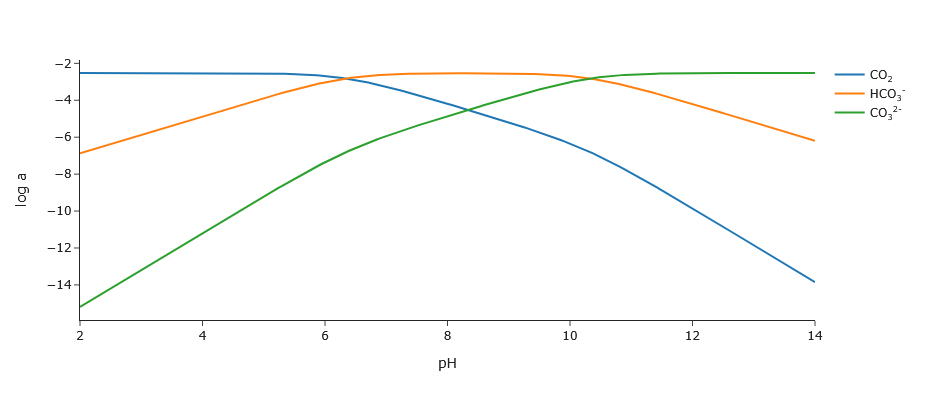

In [4]:
basis(["CO2", "H2O", "NH3", "H2S", "O2(g)", "H+"])
species(["CO2", "HCO3-", "CO3-2"])
a = affinity(pH=[2,14], T=25)
e = equilibrate(a)
_ = diagram(e, width=500, height=400, interactive=True)

The y-axis represents log activity. It shows predicted distributions of carbonate species activities as a function of pH. The total log activity of carbonate species at any point along pH must sum to a log activity of log(10<sup>-3</sup> + 10<sup>-3</sup> + 10<sup>-3</sup>) = -2.5229. This is because we have 3 carbonate species in our model system, each with a log activity of 10<sup>-3</sup>.

Let's create a similar figure to the one above, but with fractional abundances ("degree of formation") by setting `alpha=True` in the `diagram` function

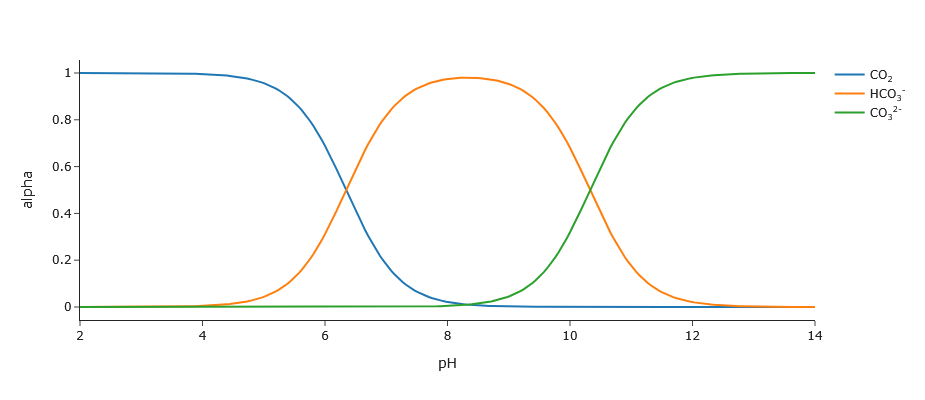

In [5]:
_ = diagram(e, alpha=True, width=500, height=400, interactive=True)

Create a predominance diagram by providing two variables to the `affinity` function. For example, here is a predominance diagram of carbonate species along the liquid-vapor saturation curve as a function of temperature (0 to 350 °C) and pH (2 to 14).

affinity: pressure is Psat
affinity: variable 2 is log10(a_H+) at 256 values from -2 to -14
subcrt: 8 species at 256 values of T (ºC) and Psat (wet) [energy units: J]


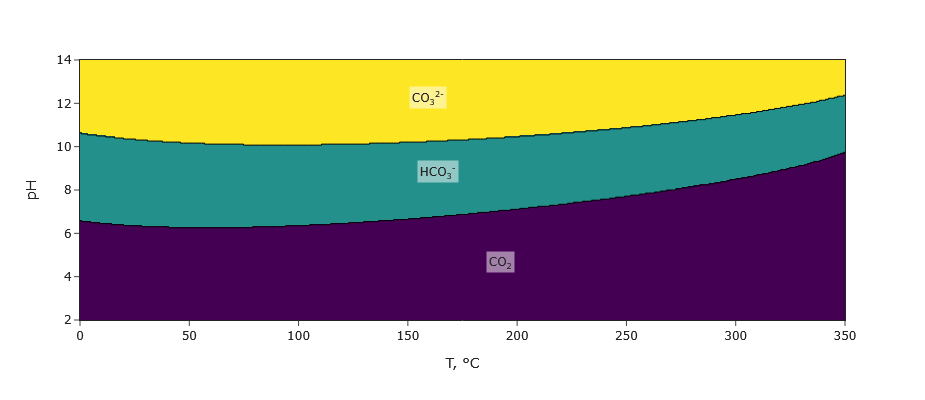

In [6]:
a = affinity(pH=[2, 14], T=[0, 350])
_ = diagram(a, width=500, height=400, interactive=True)

Increase the resolution by performing more calculations in the grid. Let's try 600 by 600 calculations in this pH-temperature space. Note that 600 has been added as a third term in the pH and T lists and will define the number of calculations. The result takes longer to calculate but looks much smoother than the plot above:

affinity: pressure is Psat
subcrt: 8 species at 600 values of T (ºC) and Psat (wet) [energy units: J]


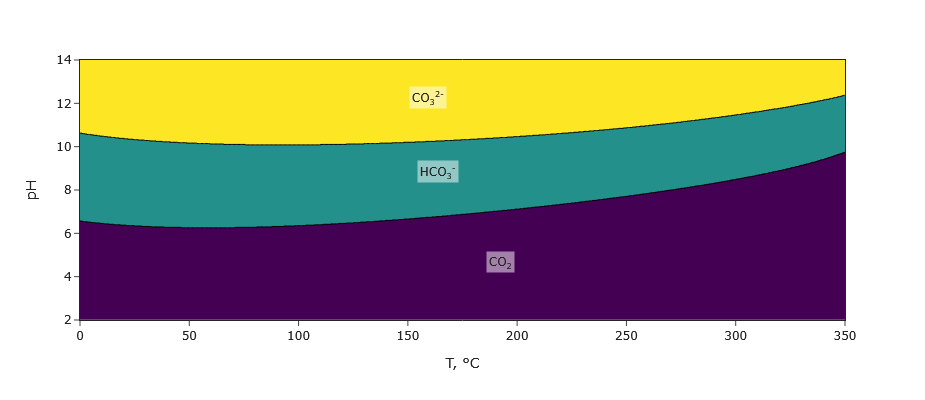

In [7]:
a = affinity(pH=[2, 14, 600], T=[0, 350, 600])
_ = diagram(a, width=500, height=400, interactive=True)

Here is another example. This time, let's create an activity diagram of Al$^{3+}$ species at 25 $^{\circ}$C and 1 bar as a function of pH.

info_character: found H2O(liq) [water]; also available in gas
info_character: found O2(aq); also available in gas
affinity: temperature is 25 ºC
affinity: pressure is Psat
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -8
subcrt: 8 species at 25 ºC and Psat (wet) [energy units: J]


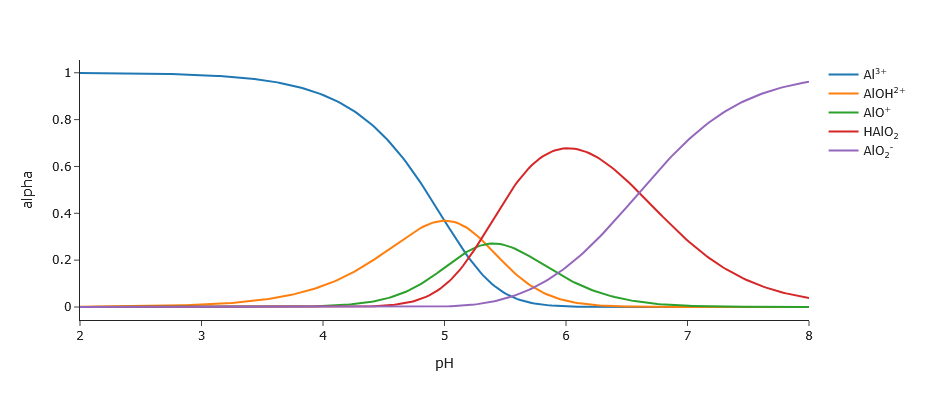

In [8]:
basis(["Al+3","H2O","O2","H+"], [-3,0,-80,-7])
species(["Al+3","AlOH+2","AlO+","HAlO2", "AlO2-"])
a = affinity(pH=[2, 8], T=25)
_ = diagram(a, alpha=True, width=500, height=400, interactive=True)

Add a second variable to create a predominance diagram. For instance, here is a predominance diagram of Al$^{3+}$ species as a function of pH and temperature:

affinity: pressure is Psat
affinity: variable 2 is log10(a_H+) at 256 values from 0 to -8
subcrt: 8 species at 256 values of T (ºC) and Psat (wet) [energy units: J]


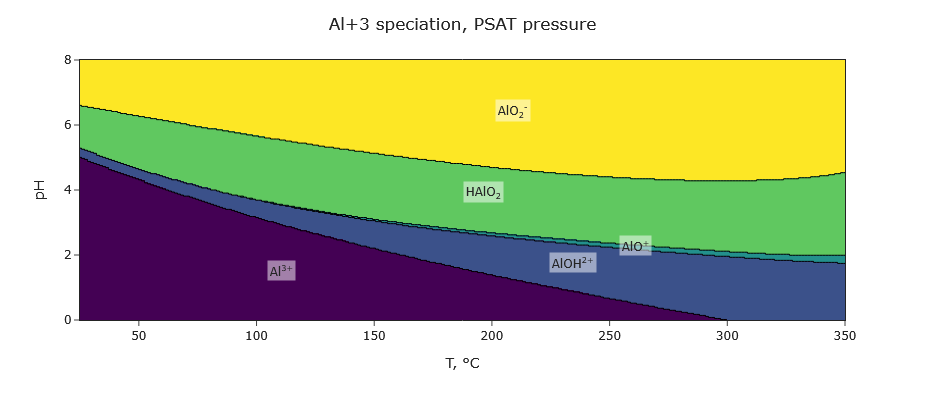

In [9]:
a = affinity(pH=[0, 8], T=[25, 350])
_ = diagram(a, width=500, height=400, interactive=True, main="Al+3 speciation, PSAT pressure") 

Next, let's create an Eh-pH diagram of aqueous sulfur species at 250 °C and 2000 bars. Make sure that "e-" is among your basis species to allow `Eh` as a parameter in `affinity`.

info_character: found H2O(liq) [water]; also available in gas
info_character: found H2S(aq); also available in gas
info_character: found H2S(aq); also available in gas
affinity: temperature is 250 ºC
affinity: pressure is 2000 bar
affinity: variable 1 is log10(a_H+) at 256 values from 0 to -12
subcrt: 7 species at 250 ºC and 2000.00 bar (wet) [energy units: J]


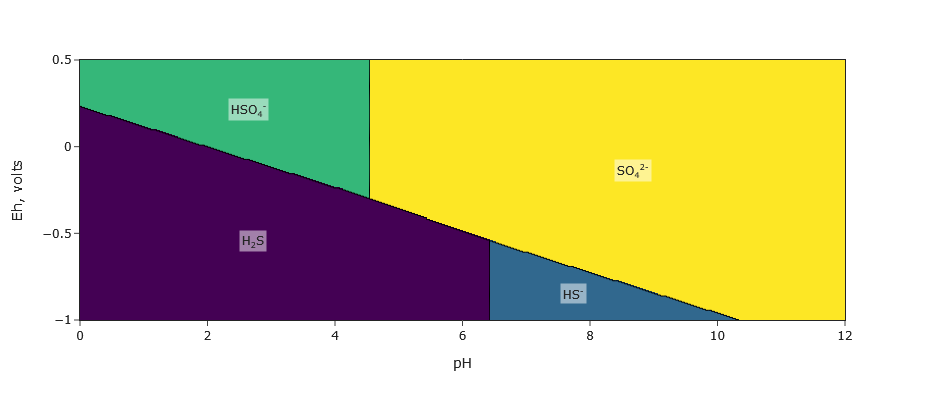

In [10]:
basis(["H2O", "H2S", "e-", "H+"])
species(["H2S", "HS-", "HSO4-", "SO4-2"])
a = affinity(pH=[0, 12], Eh=[-1, 0.5], T=250, P=2000)
_ = diagram(a, messages=False, width=500, height=400, interactive=True)

A version indicating the stable region of water is shown below. The region in the lower left is where H$_{2(g)}$ is more stable than water, and the region in the upper right is where O$_{2(g)}$ is more stable than water.

info_character: found H2S(aq); also available in gas
affinity: temperature is 250 ºC
affinity: pressure is 2000 bar
affinity: variable 1 is log10(a_H+) at 256 values from 0 to -12
subcrt: 7 species at 250 ºC and 2000.00 bar (wet) [energy units: J]


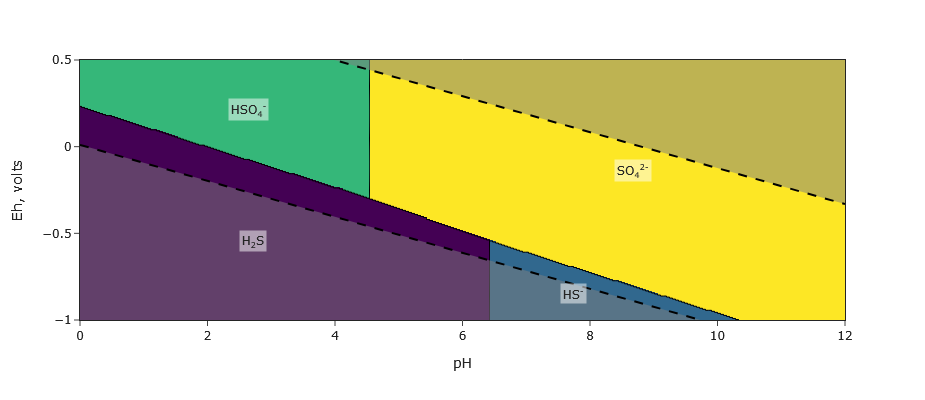

In [11]:
basis(["H2O", "H2S", "e-", "H+"])
species(["H2S", "HS-", "HSO4-", "SO4-2"])
a = affinity(pH=[0, 12], Eh=[-1, 0.5], T=250, P=2000)
d = diagram(a, messages=False, width=500, height=400, interactive=True, plot_it=False)
w = water_lines(d, lwd=2, messages=False) # "lwd" sets line thickness for the water lines

Congratulations! You now have experience with the overall process of making activity diagrams with WORM after completing Part 1 of this demo. Parts 2-4 go into much more depth

End of demo